# Summary
### There has been increased escalations on service delivery and client satisfaction levels came down by 8 percentage points.
### Mr. Brain decided to initiate a data science project , which analyses the current employee data and find the core underlying causes of this performance issues. Mr. Brain, being a data scientist himself, expects the findings of this project will help him to take right course of actions. He also expects a clear indicators of non performing employees, so that any penalization of non-performing employee, if required, may not significantly affect other employee morals

## The following insights are expected from this project.
1. Department wise performances
2. Top 3 Important Factors effecting employee performance
3. A trained model which can predict the employee performance based on factors as inputs. This will be used to hire employees
4. Recommendations to improve the employee performance based on insights from analysis.

# Importing Libraries

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

# Importing data

In [3]:
df=pd.read_excel("INX_Future_Inc_Employee_Performance_CDS_Project2_Data_V1.8.xls")

In [4]:
df.head()

,EmpNumber,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,...,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
0,E1001000,32,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,10,3,...,4,10,2,2,10,7,0,8,No,3
1,E1001006,47,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,14,4,...,4,20,2,3,7,7,1,7,No,3
2,E1001007,40,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Frequently,5,4,...,3,20,2,3,18,13,1,12,No,4
3,E1001009,41,Male,Human Resources,Divorced,Human Resources,Manager,Travel_Rarely,10,4,...,2,23,2,2,21,6,12,6,No,3
4,E1001010,60,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,16,4,...,4,10,1,3,2,2,2,2,No,3


# Overview of data

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 28 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   EmpNumber                     1200 non-null   object
 1   Age                           1200 non-null   int64 
 2   Gender                        1200 non-null   object
 3   EducationBackground           1200 non-null   object
 4   MaritalStatus                 1200 non-null   object
 5   EmpDepartment                 1200 non-null   object
 6   EmpJobRole                    1200 non-null   object
 7   BusinessTravelFrequency       1200 non-null   object
 8   DistanceFromHome              1200 non-null   int64 
 9   EmpEducationLevel             1200 non-null   int64 
 10  EmpEnvironmentSatisfaction    1200 non-null   int64 
 11  EmpHourlyRate                 1200 non-null   int64 
 12  EmpJobInvolvement             1200 non-null   int64 
 13  EmpJobLevel       

# Converting few categorical data with there labels.
#### This will help us in analysing the categorical data in a better way.

### Education Level

In [6]:
EmpEducationLevel_final= []
for i in df["EmpEducationLevel"]:
    if (i == 1 ):
        EmpEducationLevel_final.append("Below College")
    elif (i == 2 ) :
        EmpEducationLevel_final.append("College") 
    elif (i == 3 ) :
        EmpEducationLevel_final.append("Bachelor") 
    elif (i == 4 ) :
        EmpEducationLevel_final.append("Master")
    else:
        EmpEducationLevel_final.append("Doctor")   

In [7]:
df['EmpEducationLevel_final'] = EmpEducationLevel_final

### Environment Satisfaction

In [8]:
EmpEnvironmentSatisfaction_final= []
for i in df["EmpEnvironmentSatisfaction"]:
    if (i == 1 ):
        EmpEnvironmentSatisfaction_final.append("Low")
    elif (i == 2 ) :
        EmpEnvironmentSatisfaction_final.append("Medium") 
    elif (i == 3 ) :
        EmpEnvironmentSatisfaction_final.append("High") 
    else:
        EmpEnvironmentSatisfaction_final.append("Very High")  

In [9]:
df['EmpEnvironmentSatisfaction_final'] = EmpEnvironmentSatisfaction_final

### Job Involvement

In [10]:
EmpJobInvolvement_final= []
for i in df["EmpJobInvolvement"]:
    if (i == 1 ):
        EmpJobInvolvement_final.append("Low")
    elif (i == 2 ) :
        EmpJobInvolvement_final.append("Medium") 
    elif (i == 3 ) :
        EmpJobInvolvement_final.append("High") 
    else:
        EmpJobInvolvement_final.append("Very High") 

In [11]:
df['EmpJobInvolvement_final'] = EmpJobInvolvement_final

### Job Satisfaction

In [12]:
EmpJobSatisfaction_final= []
for i in df["EmpJobSatisfaction"]:
    if (i == 1 ):
        EmpJobSatisfaction_final.append("Low")
    elif (i == 2 ) :
        EmpJobSatisfaction_final.append("Medium") 
    elif (i == 3 ) :
        EmpJobSatisfaction_final.append("High") 
    else:
        EmpJobSatisfaction_final.append("Very High") 

In [13]:
df['EmpJobSatisfaction_final'] = EmpJobSatisfaction_final

### Relationship Satisfaction

In [14]:
RelationshipSatisfaction_final= []
for i in df["EmpRelationshipSatisfaction"]:
    if (i == 1 ):
        RelationshipSatisfaction_final.append("Low")
    elif (i == 2 ) :
        RelationshipSatisfaction_final.append("Medium") 
    elif (i == 3 ) :
        RelationshipSatisfaction_final.append("High") 
    else:
        RelationshipSatisfaction_final.append("Very High") 

In [15]:
df['EmpRelationshipSatisfaction_final'] = RelationshipSatisfaction_final

### Performance Rating

In [16]:
PerformanceRating_final= []
for i in df["PerformanceRating"]:
    if (i == 1 ):
        PerformanceRating_final.append("Low")
    elif (i == 2 ) :
        PerformanceRating_final.append("Good") 
    elif (i == 3 ) :
        PerformanceRating_final.append("Excellent") 
    else:
        PerformanceRating_final.append("Outstanding") 

In [17]:
df['PerformanceRating_final'] = PerformanceRating_final

### Work Life Balance

In [18]:
EmpWorkLifeBalance_final= []
for i in df["EmpWorkLifeBalance"]:
    if (i == 1 ):
        EmpWorkLifeBalance_final.append("Bad")
    elif (i == 2 ) :
        EmpWorkLifeBalance_final.append("Good") 
    elif (i == 3 ) :
        EmpWorkLifeBalance_final.append("Better") 
    else:
        EmpWorkLifeBalance_final.append("Best")

In [19]:
df['EmpWorkLifeBalance_final'] = EmpWorkLifeBalance_final

In [20]:
df.columns

Index(['EmpNumber', 'Age', 'Gender', 'EducationBackground', 'MaritalStatus',
       'EmpDepartment', 'EmpJobRole', 'BusinessTravelFrequency',
       'DistanceFromHome', 'EmpEducationLevel', 'EmpEnvironmentSatisfaction',
       'EmpHourlyRate', 'EmpJobInvolvement', 'EmpJobLevel',
       'EmpJobSatisfaction', 'NumCompaniesWorked', 'OverTime',
       'EmpLastSalaryHikePercent', 'EmpRelationshipSatisfaction',
       'TotalWorkExperienceInYears', 'TrainingTimesLastYear',
       'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany',
       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'Attrition', 'PerformanceRating',
       'EmpEducationLevel_final', 'EmpEnvironmentSatisfaction_final',
       'EmpJobInvolvement_final', 'EmpJobSatisfaction_final',
       'EmpRelationshipSatisfaction_final', 'PerformanceRating_final',
       'EmpWorkLifeBalance_final'],
      dtype='object')

# Creating df_finals to avoid duplicacy of categorical data.

In [21]:
df_final= df[['EmpNumber', 'Age', 'Gender', 'EducationBackground', 'MaritalStatus',
       'EmpDepartment', 'EmpJobRole', 'BusinessTravelFrequency',
       'DistanceFromHome',
       'EmpHourlyRate',  'EmpJobLevel',
       'NumCompaniesWorked', 'OverTime',
       'EmpLastSalaryHikePercent', 
       'TotalWorkExperienceInYears', 'TrainingTimesLastYear',
        'ExperienceYearsAtThisCompany',
       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'Attrition', 
       'EmpEducationLevel_final', 'EmpEnvironmentSatisfaction_final',
       'EmpJobInvolvement_final', 'EmpJobSatisfaction_final',
       'EmpRelationshipSatisfaction_final', 'PerformanceRating_final',
       'EmpWorkLifeBalance_final']]

In [22]:
df_final.head()

,EmpNumber,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpHourlyRate,...,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,EmpEducationLevel_final,EmpEnvironmentSatisfaction_final,EmpJobInvolvement_final,EmpJobSatisfaction_final,EmpRelationshipSatisfaction_final,PerformanceRating_final,EmpWorkLifeBalance_final
0,E1001000,32,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,10,55,...,0,8,No,Bachelor,Very High,High,Very High,Very High,Excellent,Good
1,E1001006,47,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,14,42,...,1,7,No,Master,Very High,High,Low,Very High,Excellent,Better
2,E1001007,40,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Frequently,5,48,...,1,12,No,Master,Very High,Medium,Low,High,Outstanding,Better
3,E1001009,41,Male,Human Resources,Divorced,Human Resources,Manager,Travel_Rarely,10,73,...,12,6,No,Master,Medium,Medium,Very High,Medium,Excellent,Good
4,E1001010,60,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,16,84,...,2,2,No,Master,Low,High,Low,Very High,Excellent,Better


In [23]:
df_final.to_csv('df_final.csv')

# --------------------------------------------------

# EXPLORATORY DATA ANALYSIS
### Libraries for statistical ananlysis and visualization of the data.
### Analysing the data

In [23]:
import pandas_profiling
df_final.profile_report()

In [109]:
import sweetviz as sv

my_report = sv.analyze(df_final)
my_report.show_html() # Default arguments will generate to "SWEETVIZ_REPORT.html"


Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


Shape of your Data Set loaded: (1200, 29)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  0
    Number of Integer-Categorical Columns =  12
    Number of String-Categorical Columns =  11
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  3
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  2
    Number of Columns to Delete =  0
    28 Predictors classified...
        This does not include the Target column(s)
        2 variables removed since they were ID or low-information variables

################ Multi_Classification VISUALIZATION Started #####################


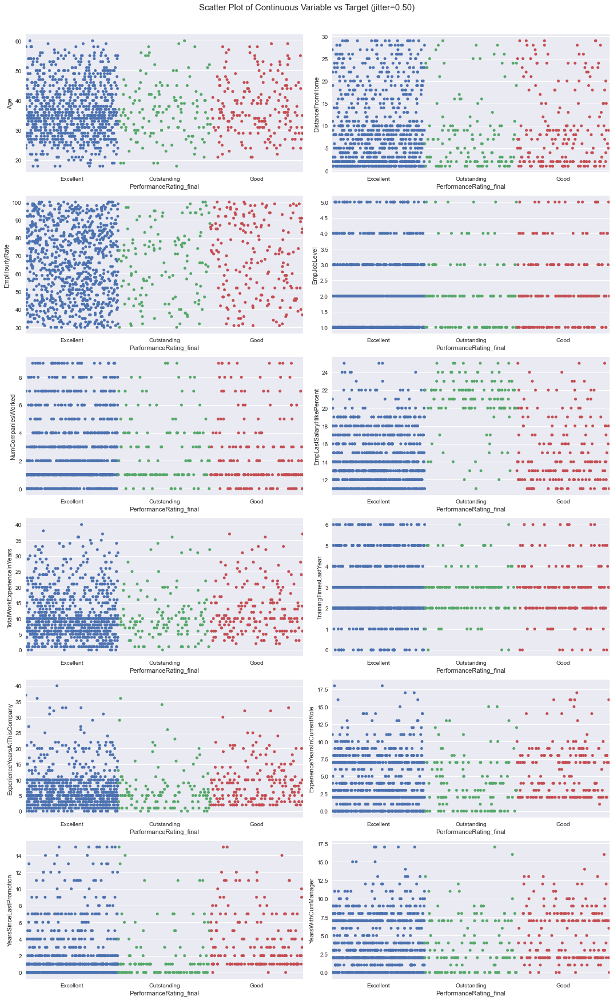

Total Number of Scatter Plots = 78


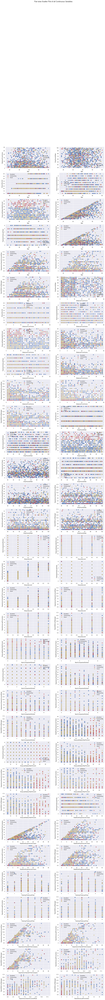

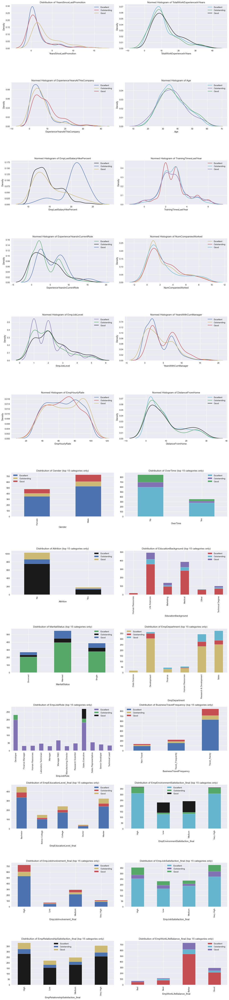

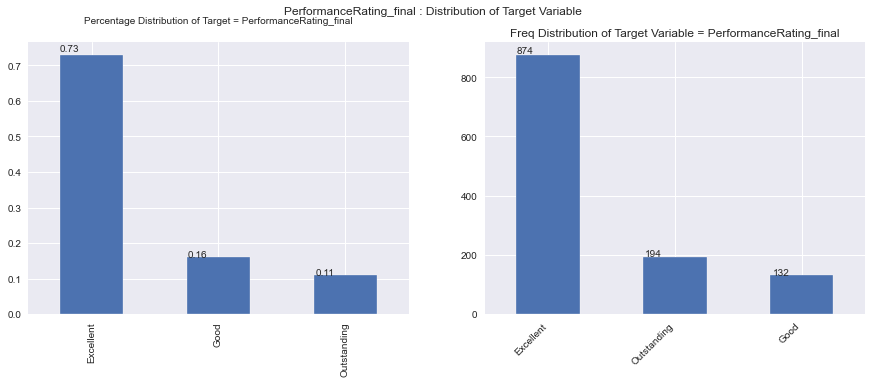

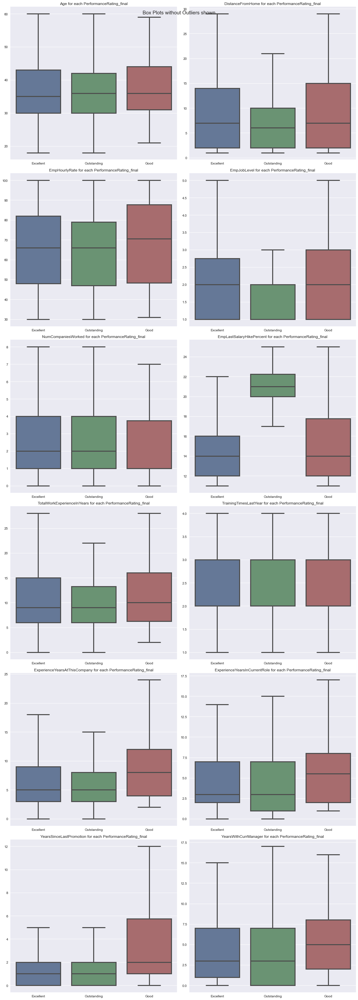

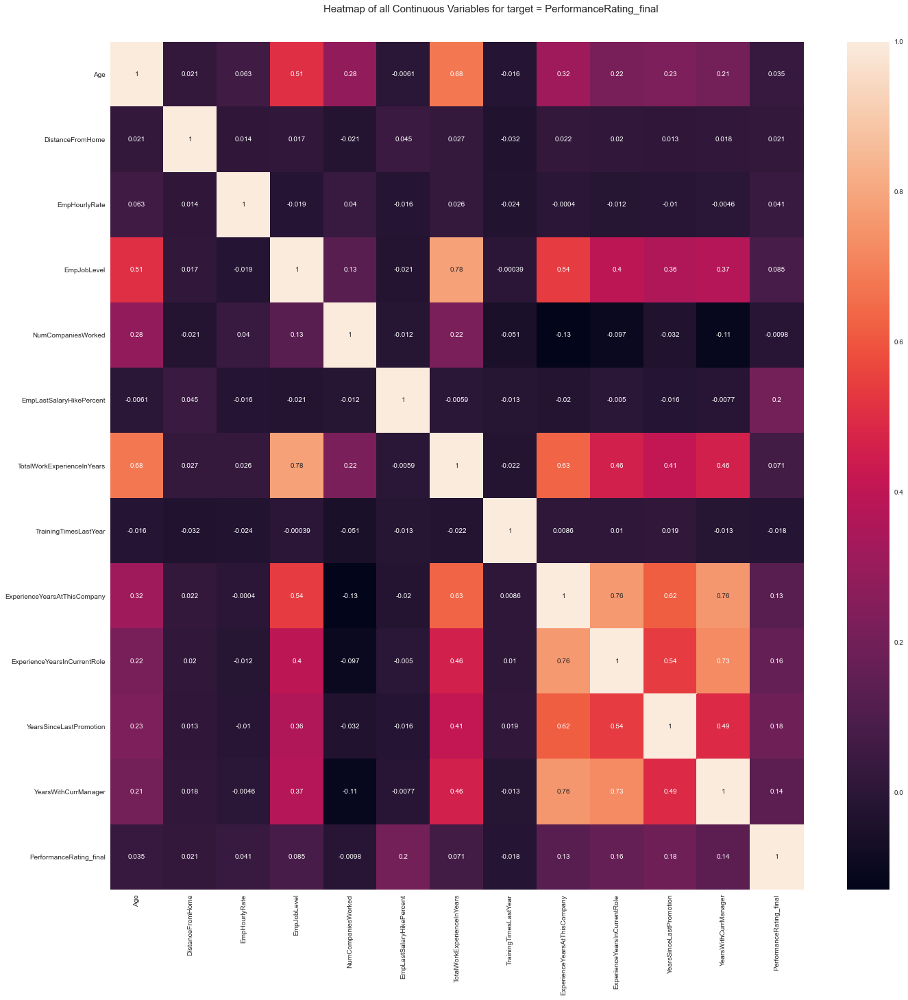

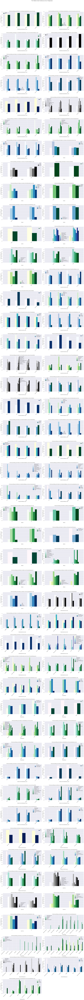

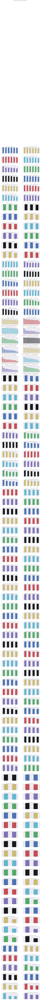

Time to run AutoViz (in seconds) = 77.958

 ###################### VISUALIZATION Completed ########################


In [30]:
from autoviz.AutoViz_Class import AutoViz_Class

AV = AutoViz_Class()
filename = "df_final.csv"

dft = AV.AutoViz(
    filename,
    sep=",",
    depVar="PerformanceRating_final",
    dfte=None,
    header=0,
    verbose=0,
    lowess=False,
    chart_format="svg",
    max_rows_analyzed=150000,
    max_cols_analyzed=30,
)

# --------------------------------------------------

# Finding null values

In [35]:
df_final.isnull().sum()

EmpNumber                            0
Age                                  0
Gender                               0
EducationBackground                  0
MaritalStatus                        0
EmpDepartment                        0
EmpJobRole                           0
BusinessTravelFrequency              0
DistanceFromHome                     0
EmpHourlyRate                        0
EmpJobLevel                          0
NumCompaniesWorked                   0
OverTime                             0
EmpLastSalaryHikePercent             0
TotalWorkExperienceInYears           0
TrainingTimesLastYear                0
ExperienceYearsAtThisCompany         0
ExperienceYearsInCurrentRole         0
YearsSinceLastPromotion              0
YearsWithCurrManager                 0
Attrition                            0
EmpEducationLevel_final              0
EmpEnvironmentSatisfaction_final     0
EmpJobInvolvement_final              0
EmpJobSatisfaction_final             0
EmpRelationshipSatisfacti

# --------------------------------------------------

## Finding the score of the performance from the rating.

In [44]:
a= df['PerformanceRating']/4
df['performance score'] = a

## Grouping into department and finding the mean will give us the exact score which we want.

In [39]:
Dwp=df.groupby(by="EmpDepartment").mean()

In [40]:
Dwp

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,PerformanceRating,performance score
EmpDepartment,,,,,,,,,,,,,,,,,,,,
Data Science,38.000000,9.650000,2.750000,2.950000,62.250000,2.900000,2.100000,2.700000,2.100000,16.450000,2.500000,12.100000,2.950000,2.500000,5.850000,3.000000,1.550000,3.800000,3.050000,0.762500
Development,36.653740,8.789474,2.853186,2.709141,65.828255,2.789474,1.939058,2.747922,2.817175,15.204986,2.833795,11.008310,2.756233,2.686981,6.725762,4.036011,2.041551,3.958449,3.085873,0.771468
Finance,36.387755,11.877551,3.061224,2.836735,66.693878,2.877551,1.938776,2.653061,2.306122,15.367347,2.693878,10.877551,2.836735,2.673469,7.204082,4.693878,1.959184,4.428571,2.775510,0.693878
Human Resources,38.425926,8.666667,3.000000,2.629630,65.703704,2.777778,2.055556,2.555556,3.129630,14.740741,2.888889,11.851852,2.574074,2.925926,7.425926,3.574074,1.814815,3.888889,2.925926,0.731481
Research & Development,37.475219,9.230321,2.874636,2.775510,67.023324,2.685131,1.997085,2.720117,2.693878,15.300292,2.615160,11.746356,2.784257,2.743440,6.988338,4.306122,2.244898,4.029155,2.921283,0.730321
Sales,36.455764,9.160858,2.916890,2.651475,65.319035,2.683646,2.273458,2.766756,2.501340,15.152815,2.713137,11.201072,2.831099,2.796247,7.498660,4.646113,2.415550,4.321716,2.860590,0.715147


In [41]:
Dwp['Department']= ['Data Science','Development','Finance','Human Resources','Research & Development','Sales']

# Figure showing the comparision of performances of different department.

<AxesSubplot:xlabel='Department', ylabel='performance score'>

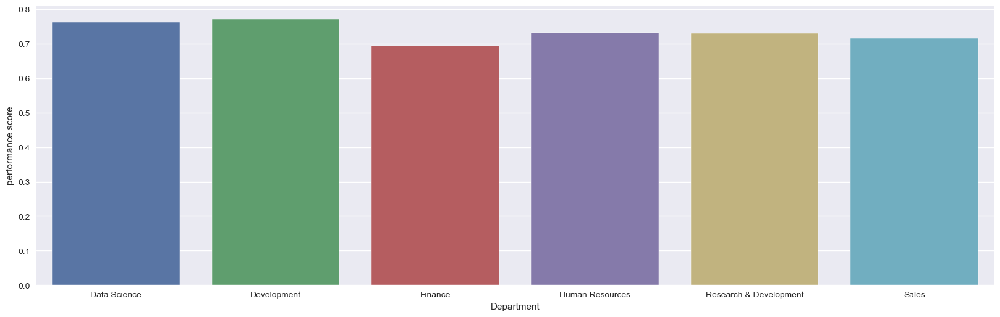

In [43]:
fig = plt.figure(figsize=(20,6), dpi=100)
sns.barplot(x='Department' ,y='performance score',data=Dwp)

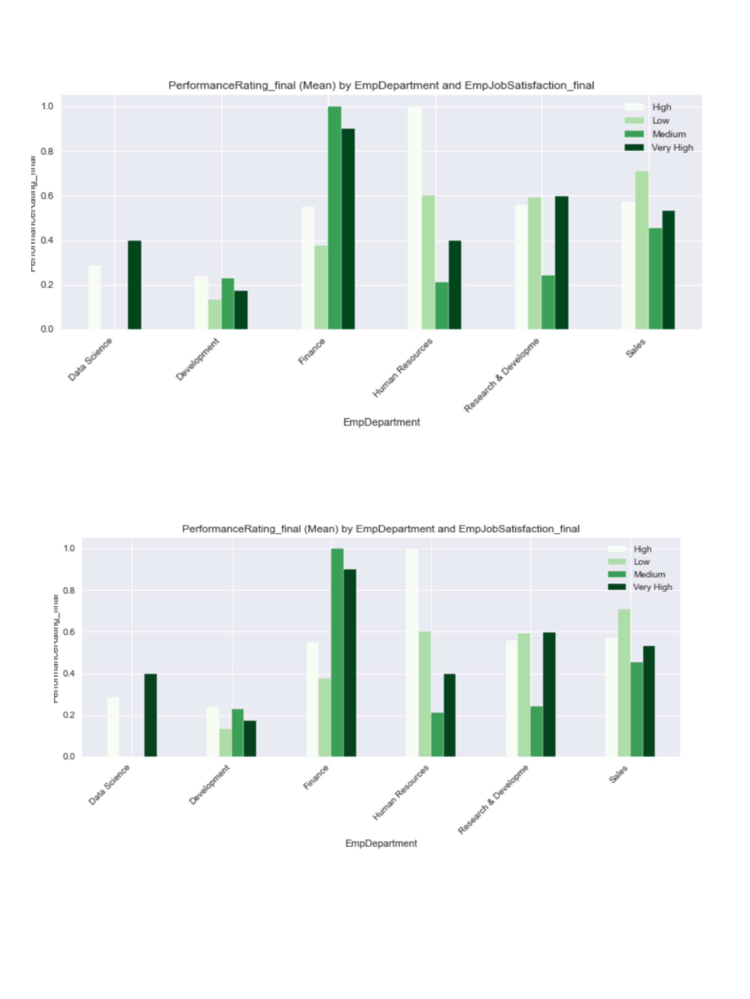

In [48]:
from PIL import Image
Image1 = Image.open("/Users/ayushmehta/Downloads/Capston/IBAC/PicsArt_07-08-05.12.54.jpg");
Image1

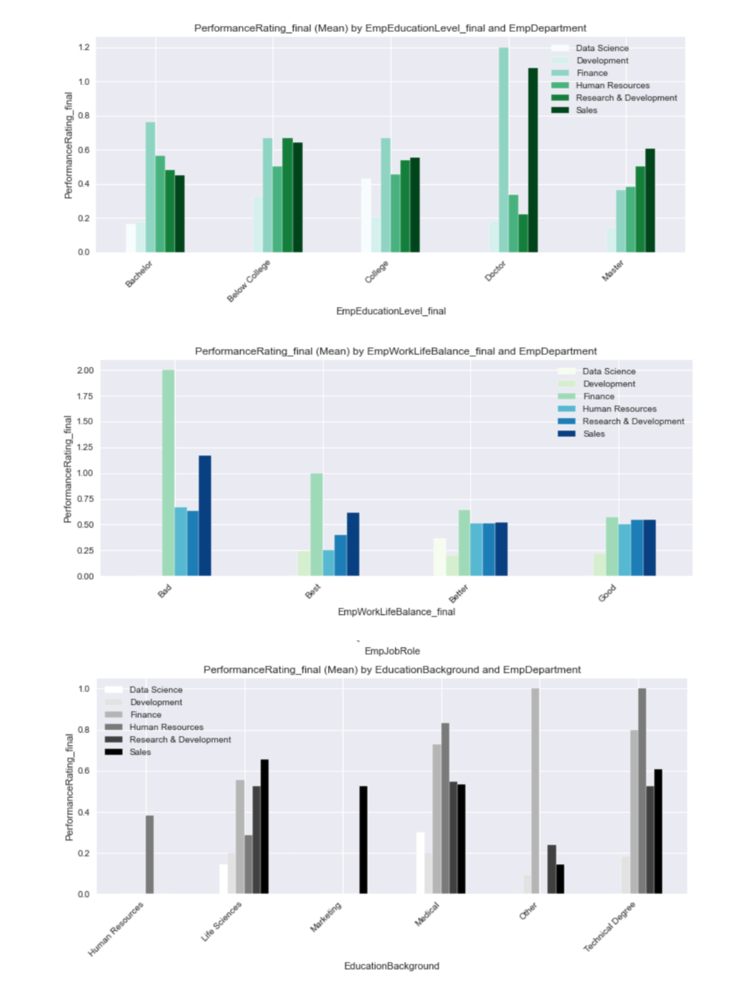

In [49]:
Image2 = Image.open("/Users/ayushmehta/Downloads/Capston/IBAC/PicsArt_07-08-05.12.14.jpg");
Image2

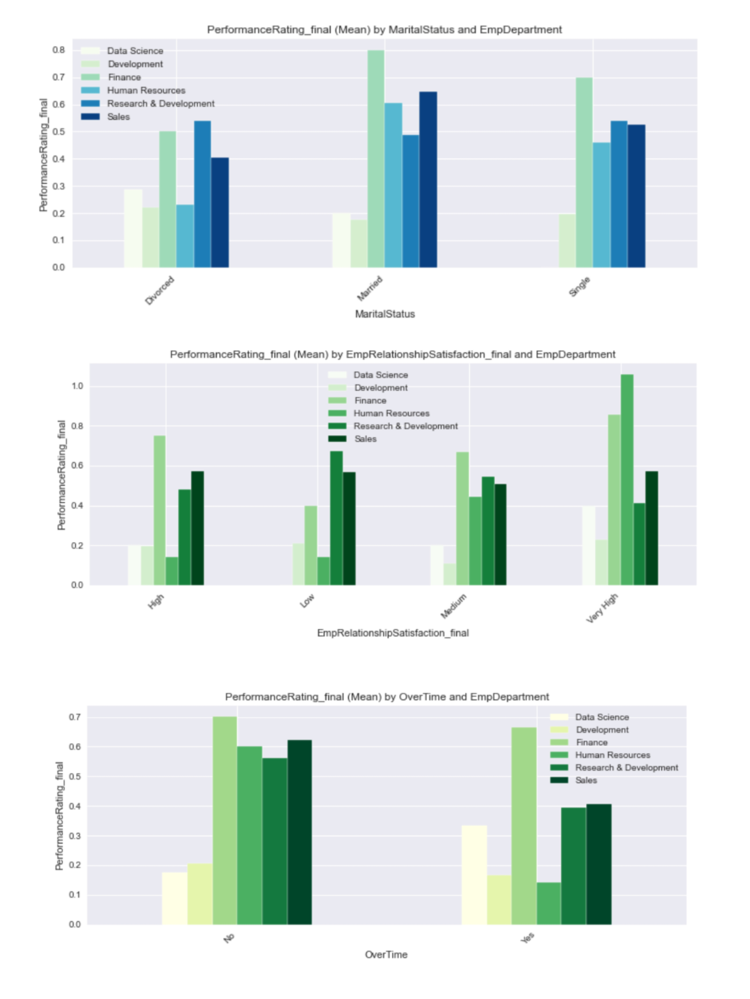

In [50]:
Image3 = Image.open("/Users/ayushmehta/Downloads/Capston/IBAC/PicsArt_07-08-05.10.48.jpg");
Image3

# Ranking of department wise performances 
### 1. Development
### 2. Data Science
### 3. Human Resources
### 4. Research & Development
### 5. Sales
### 6. Finance

# --------------------------------------------------

# Finding correlation between the categorical columns
## Chesq method is used, giving us the correlation value between the "PerformanceRating" and different columns.

In [65]:
a=['Age', 'Gender', 'EducationBackground', 'MaritalStatus',
       'EmpDepartment', 'EmpJobRole', 'BusinessTravelFrequency',
       'DistanceFromHome', 'EmpEducationLevel', 'EmpEnvironmentSatisfaction',
       'EmpHourlyRate', 'EmpJobInvolvement', 'EmpJobLevel',
       'EmpJobSatisfaction', 'NumCompaniesWorked', 'OverTime',
       'EmpLastSalaryHikePercent', 'EmpRelationshipSatisfaction',
       'TotalWorkExperienceInYears', 'TrainingTimesLastYear',
       'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany',
       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'Attrition', 'PerformanceRating']

In [66]:
from scipy.stats import chisquare
from scipy.stats import chi2_contingency
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x,y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2/n
    r,k = confusion_matrix.shape
    phi2corr = max(0, phi2-((k-1)*(r-1))/(n-1))
    rcorr = r-((r-1)**2)/(n-1)
    kcorr = k-((k-1)**2)/(n-1)
    return np.sqrt(phi2corr/min((kcorr-1),(rcorr-1)))

# Calling the function for all columns

In [67]:
for i in a:
    print(i,':-',cramers_v(df['PerformanceRating'], df[i]))

Age :- 0.0
Gender :- 0.0
EducationBackground :- 0.009340696353324872
MaritalStatus :- 0.02981572450932545
EmpDepartment :- 0.15866684724956717
EmpJobRole :- 0.1604859436054905
BusinessTravelFrequency :- 0.012822437919962326
DistanceFromHome :- 0.0
EmpEducationLevel :- 0.023917449353922413
EmpEnvironmentSatisfaction :- 0.36519231714206807
EmpHourlyRate :- 0.10020630984940081
EmpJobInvolvement :- 0.0
EmpJobLevel :- 0.03797560526252152
EmpJobSatisfaction :- 0.04940136939486334
NumCompaniesWorked :- 0.0
OverTime :- 0.0879797761525058
EmpLastSalaryHikePercent :- 0.476073067612609
EmpRelationshipSatisfaction :- 0.0
TotalWorkExperienceInYears :- 0.09543569507365554
TrainingTimesLastYear :- 0.0
EmpWorkLifeBalance :- 0.09664057212073907
ExperienceYearsAtThisCompany :- 0.18761024637428966
ExperienceYearsInCurrentRole :- 0.20115358188360535
YearsSinceLastPromotion :- 0.23893109860243672
YearsWithCurrManager :- 0.1471345877027025
Attrition :- 0.02171584245658214
PerformanceRating :- 1.0


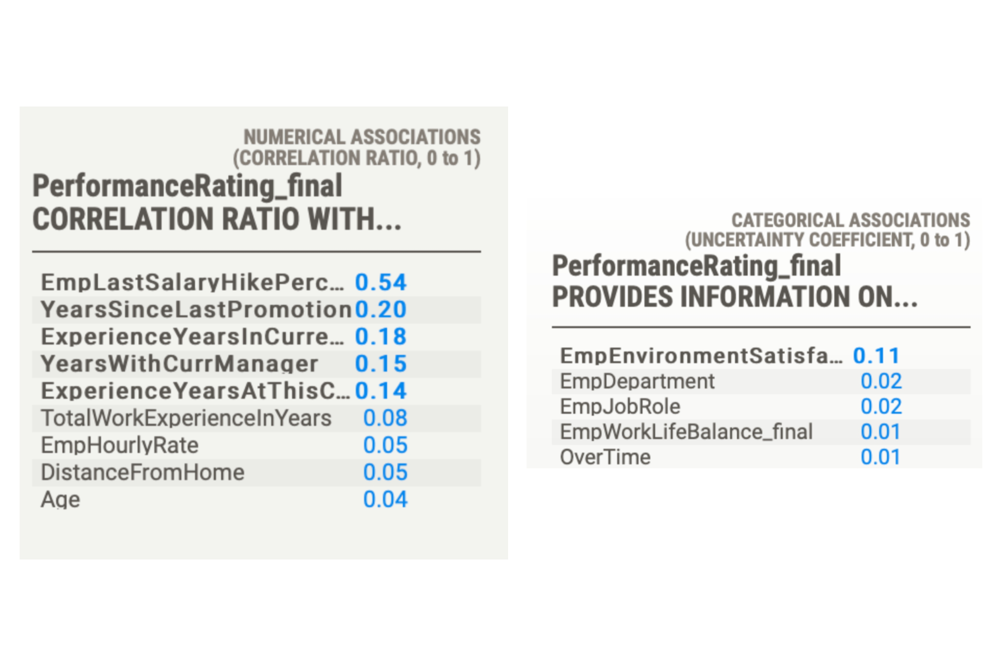

In [40]:
from PIL import Image
myImage = Image.open("/Users/ayushmehta/Downloads/Capston/IBAC/PicsArt_07-08-05.19.19.jpg");
myImage

# Top 3 Important Factors effecting employee performance
### EmpLastSalaryHikePercent 
### YearsSinceLastPromotion
### ExperienceYearsInCurrentRole

# Comparision of important Factors effecting employee performance

Text(0.5, 1.0, 'Experience YearsIn Current Role')

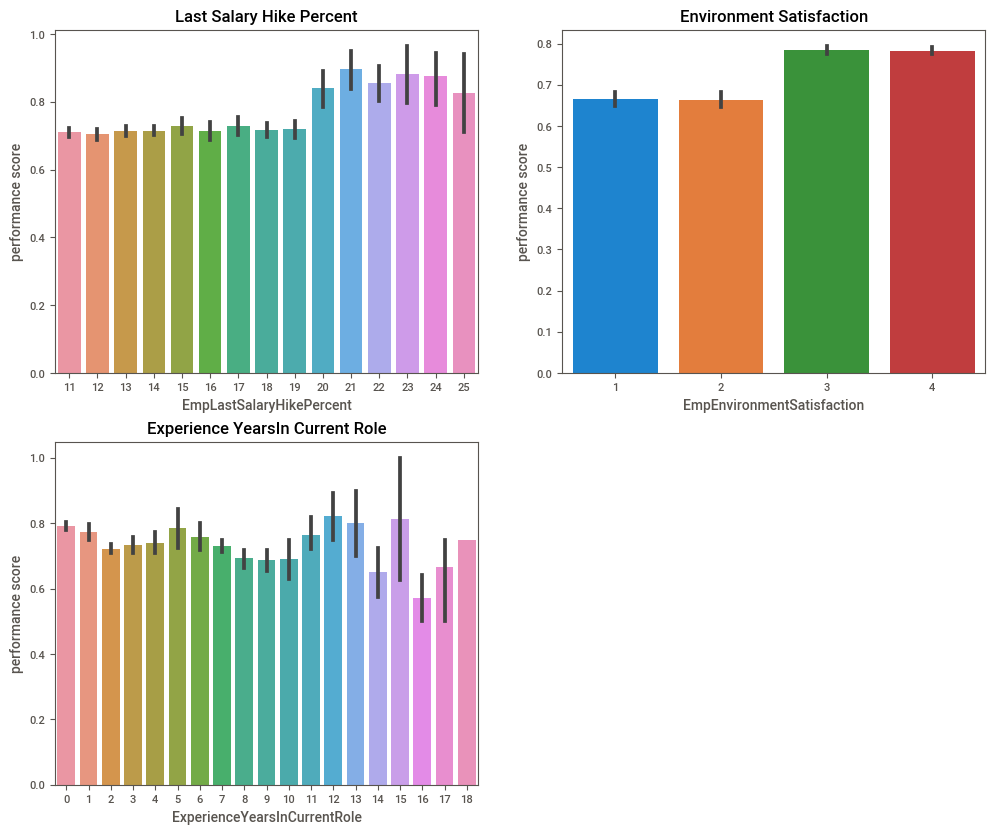

In [45]:
fig = plt.figure(figsize=(12,10), dpi=100)


plt.subplot(2,2,1)
sns.barplot(x='EmpLastSalaryHikePercent',y='performance score',data=df)
plt.title("Last Salary Hike Percent")


plt.subplot(2,2,2)
sns.barplot(x='EmpEnvironmentSatisfaction',y='performance score',data=df)
plt.title("Environment Satisfaction")

plt.subplot(2,2,3)
sns.barplot(x='ExperienceYearsInCurrentRole',y='performance score',data=df)
plt.title("Experience YearsIn Current Role")

# --------------------------------------------------

In [93]:
a = df[df['performance score'] <= .5]

In [100]:
a['performance score'].count()

194

## There are 0 employes having low performance. 
## There are 194 employes performing good.

# --------------------------------------------------

# Creating a model

# Importing data

In [110]:
df=pd.read_excel("INX_Future_Inc_Employee_Performance_CDS_Project2_Data_V1.8.xls")

# One hot encoding
1. For categorical variables where no such ordinal relationship exists, the integer encoding is not enough.
2. In fact, using this encoding and allowing the model to assume a natural ordering between categories may result in poor performance or unexpected results (predictions halfway between categories).
3. In this case, a one-hot encoding can be applied to the integer representation. This is where the integer encoded variable is removed and a new binary variable is added for each unique integer value.

In [26]:
import category_encoders as ce
#Create object for one-hot encoding
encoder=ce.OneHotEncoder(cols='Age',handle_unknown='return_nan',return_df=True,use_cat_names=True)
#Fit and transform Data
age_encoded = encoder.fit_transform(df)
#Create object for one-hot encoding
encoder=ce.OneHotEncoder(cols='Gender',handle_unknown='return_nan',return_df=True,use_cat_names=True)
#Fit and transform Data
Gender_encoded = encoder.fit_transform(age_encoded)
encoder=ce.OneHotEncoder(cols='EducationBackground',handle_unknown='return_nan',return_df=True,use_cat_names=True)
#Fit and transform Data
EducationBackground_encoded = encoder.fit_transform(Gender_encoded)
#Create object for one-hot encoding
encoder=ce.OneHotEncoder(cols='MaritalStatus',handle_unknown='return_nan',return_df=True,use_cat_names=True)
#Fit and transform Data
MaritalStatus_encoded = encoder.fit_transform(EducationBackground_encoded)
#Create object for one-hot encoding
encoder=ce.OneHotEncoder(cols='EmpDepartment',handle_unknown='return_nan',return_df=True,use_cat_names=True)
#Fit and transform Data
EmpDepartment_encoded = encoder.fit_transform(MaritalStatus_encoded)
#Create object for one-hot encoding
encoder=ce.OneHotEncoder(cols='EmpJobRole',handle_unknown='return_nan',return_df=True,use_cat_names=True)
#Fit and transform Data
EmpJobRole_encoded = encoder.fit_transform(EmpDepartment_encoded)
#Create object for one-hot encoding
encoder=ce.OneHotEncoder(cols='BusinessTravelFrequency',handle_unknown='return_nan',return_df=True,use_cat_names=True)
#Fit and transform Data
TravelFrequency_encoded= encoder.fit_transform(EmpJobRole_encoded)
#Create object for one-hot encoding
encoder=ce.OneHotEncoder(cols='OverTime',handle_unknown='return_nan',return_df=True,use_cat_names=True)
#Fit and transform Data
df_model= encoder.fit_transform(TravelFrequency_encoded)

# Spliting features and target

In [27]:
df_model.columns

Index(['EmpNumber', 'Age_32.0', 'Age_47.0', 'Age_40.0', 'Age_41.0', 'Age_60.0',
       'Age_27.0', 'Age_50.0', 'Age_28.0', 'Age_36.0',
       ...
       'YearsWithCurrManager', 'Attrition', 'PerformanceRating',
       'EmpEducationLevel_final', 'EmpEnvironmentSatisfaction_final',
       'EmpJobInvolvement_final', 'EmpJobSatisfaction_final',
       'EmpRelationshipSatisfaction_final', 'PerformanceRating_final',
       'EmpWorkLifeBalance_final'],
      dtype='object', length=111)

### The features have been selected by considering the correlation of them with the target. 

In [28]:
X=df_model[[ 
       'EmpEnvironmentSatisfaction',
       'EmpJobSatisfaction', 'NumCompaniesWorked',
       'EmpLastSalaryHikePercent', 
       'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany',
       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion','EmpJobLevel',
       'YearsWithCurrManager']]
y=df_model['PerformanceRating']

# Spliting data into train and test data

In [29]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=15)

# Initializing the model

## We are using Random forest algorithm to create our model.
## Random Forest
### Random Forest is a robust machine learning algorithm that can be used for a variety of tasks including regression and classification. It is an ensemble method, meaning that a random forest model is made up of a large number of small decision trees, called estimators, which each produce their own predictions. The random forest model combines the predictions of the estimators to produce a more accurate prediction.

In [30]:
from sklearn.ensemble import RandomForestClassifier
model1=RandomForestClassifier()

# Fitting the model
### Model fitting is the measure of how well a machine learning model generalizes data similar to that with which it was trained. A good model fit refers to a model that accurately approximates the output when it is provided with unseen inputs. Fitting refers to adjusting the parameters in the model to improve accuracy.

In [31]:
model1.fit(X_train,y_train)
y_predict= model1.predict(X_test)

# Predicting

In [32]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test,y_predict)

0.875

# Grid search for better accuracy
### Grid-search is used to find the optimal hyperparameters of a model which results in the most 'accurate' predictions.

In [33]:
from sklearn.model_selection import GridSearchCV

parameters={
'random_state':[10,11,13,15,16,17,20,19,21,22,24,23,25],
'n_estimators':[40,45,46,47,48,49,50,25,344,500,355,289], #no. of trees to make
'max_depth':[3,5,6,7,8,9,10,11,14]
}
grid_model1=GridSearchCV(RandomForestClassifier(),parameters,verbose=2)
grid_model1.fit(X_train,y_train)

Fitting 5 folds for each of 1404 candidates, totalling 7020 fits
[CV] END ......max_depth=3, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40, random_state=13; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=40,

[CV] END ......max_depth=3, n_estimators=45, random_state=19; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=19; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=19; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=19; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=22; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=22; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=45, random_state=22; total time=   0.1s
[CV] END ......max_depth=3, 

[CV] END ......max_depth=3, n_estimators=47, random_state=11; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=13; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=13; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=13; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=13; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=13; total time=   0.2s
[CV] END ......max_depth=3, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=47, random_state=16; total time=   0.1s
[CV] END ......max_depth=3, 

[CV] END ......max_depth=3, n_estimators=48, random_state=22; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=22; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=22; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=22; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=23; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=23; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=48, random_state=23; total time=   0.1s
[CV] END ......max_depth=3, 

[CV] END ......max_depth=3, n_estimators=50, random_state=15; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=15; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=16; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=16; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=16; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=16; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=16; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=3, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=3, 

[CV] END ......max_depth=3, n_estimators=25, random_state=25; total time=   0.0s
[CV] END ......max_depth=3, n_estimators=25, random_state=25; total time=   0.0s
[CV] END ......max_depth=3, n_estimators=25, random_state=25; total time=   0.0s
[CV] END ......max_depth=3, n_estimators=25, random_state=25; total time=   0.0s
[CV] END ......max_depth=3, n_estimators=25, random_state=25; total time=   0.0s
[CV] END .....max_depth=3, n_estimators=344, random_state=10; total time=   0.5s
[CV] END .....max_depth=3, n_estimators=344, random_state=10; total time=   0.5s
[CV] END .....max_depth=3, n_estimators=344, random_state=10; total time=   0.5s
[CV] END .....max_depth=3, n_estimators=344, random_state=10; total time=   0.5s
[CV] END .....max_depth=3, n_estimators=344, random_state=10; total time=   0.5s
[CV] END .....max_depth=3, n_estimators=344, random_state=11; total time=   0.5s
[CV] END .....max_depth=3, n_estimators=344, random_state=11; total time=   0.5s
[CV] END .....max_depth=3, n

[CV] END .....max_depth=3, n_estimators=500, random_state=20; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=20; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=20; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=19; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=19; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=19; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=19; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=19; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=21; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=21; total time=   0.8s
[CV] END .....max_depth=3, n_estimators=500, random_state=21; total time=   0.7s
[CV] END .....max_depth=3, n_estimators=500, random_state=21; total time=   0.7s
[CV] END .....max_depth=3, n

[CV] END .....max_depth=3, n_estimators=289, random_state=10; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=11; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=11; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=11; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=11; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=11; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=13; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=13; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=13; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=13; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=13; total time=   0.4s
[CV] END .....max_depth=3, n_estimators=289, random_state=15; total time=   0.4s
[CV] END .....max_depth=3, n

[CV] END ......max_depth=5, n_estimators=40, random_state=21; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=21; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=22; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=22; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=22; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=22; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=22; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=24; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=24; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=24; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=24; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=40, random_state=24; total time=   0.1s
[CV] END ......max_depth=5, 

[CV] END ......max_depth=5, n_estimators=46, random_state=15; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=15; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=15; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=15; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=16; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=16; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=16; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=16; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=16; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=17; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=17; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=46, random_state=17; total time=   0.1s
[CV] END ......max_depth=5, 

[CV] END ......max_depth=5, n_estimators=47, random_state=23; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=23; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=23; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=23; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=23; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=25; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=25; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=25; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=25; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=47, random_state=25; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=48, random_state=10; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=48, random_state=10; total time=   0.1s
[CV] END ......max_depth=5, 

[CV] END ......max_depth=5, n_estimators=49, random_state=17; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=17; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=17; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=20; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=20; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=20; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=20; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=20; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=19; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=19; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=19; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=49, random_state=19; total time=   0.1s
[CV] END ......max_depth=5, 

[CV] END ......max_depth=5, n_estimators=50, random_state=25; total time=   0.1s
[CV] END ......max_depth=5, n_estimators=25, random_state=10; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=10; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=10; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=10; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=10; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=11; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=11; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=11; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=11; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=11; total time=   0.0s
[CV] END ......max_depth=5, n_estimators=25, random_state=13; total time=   0.0s
[CV] END ......max_depth=5, 

[CV] END .....max_depth=5, n_estimators=344, random_state=19; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=19; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=19; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=19; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=21; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=21; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=21; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=21; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=21; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=22; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=22; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=344, random_state=22; total time=   0.5s
[CV] END .....max_depth=5, n

[CV] END .....max_depth=5, n_estimators=355, random_state=11; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=11; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=13; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=13; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=13; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=13; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=13; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=15; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=15; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=15; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=15; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=355, random_state=15; total time=   0.5s
[CV] END .....max_depth=5, n

[CV] END .....max_depth=5, n_estimators=289, random_state=22; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=22; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=22; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=22; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=22; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=24; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=24; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=24; total time=   0.5s
[CV] END .....max_depth=5, n_estimators=289, random_state=24; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=24; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=23; total time=   0.4s
[CV] END .....max_depth=5, n_estimators=289, random_state=23; total time=   0.4s
[CV] END .....max_depth=5, n

[CV] END ......max_depth=6, n_estimators=45, random_state=15; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=15; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=15; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=16; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=16; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=16; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=16; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=16; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=17; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=17; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=17; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=45, random_state=17; total time=   0.1s
[CV] END ......max_depth=6, 

[CV] END ......max_depth=6, n_estimators=46, random_state=23; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=46, random_state=23; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=46, random_state=23; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=46, random_state=23; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=46, random_state=25; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=46, random_state=25; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=46, random_state=25; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=46, random_state=25; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=46, random_state=25; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=47, random_state=10; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=47, random_state=10; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=47, random_state=10; total time=   0.1s
[CV] END ......max_depth=6, 

[CV] END ......max_depth=6, n_estimators=48, random_state=17; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=17; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=20; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=20; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=20; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=20; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=20; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=19; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=19; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=19; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=19; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=48, random_state=19; total time=   0.1s
[CV] END ......max_depth=6, 

[CV] END ......max_depth=6, n_estimators=50, random_state=10; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=10; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=10; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=10; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=10; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=11; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=11; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=11; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=11; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=11; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=13; total time=   0.1s
[CV] END ......max_depth=6, n_estimators=50, random_state=13; total time=   0.1s
[CV] END ......max_depth=6, 

[CV] END .....max_depth=6, n_estimators=500, random_state=11; total time=   0.9s
[CV] END .....max_depth=6, n_estimators=500, random_state=11; total time=   0.8s
[CV] END .....max_depth=6, n_estimators=500, random_state=13; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=13; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=13; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=13; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=13; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=15; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=15; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=15; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=15; total time=   0.7s
[CV] END .....max_depth=6, n_estimators=500, random_state=15; total time=   0.7s
[CV] END .....max_depth=6, n

[CV] END .....max_depth=6, n_estimators=355, random_state=22; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=22; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=22; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=22; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=22; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=24; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=24; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=24; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=24; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=24; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=23; total time=   0.5s
[CV] END .....max_depth=6, n_estimators=355, random_state=23; total time=   0.5s
[CV] END .....max_depth=6, n

[CV] END ......max_depth=7, n_estimators=40, random_state=15; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=16; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=16; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=16; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=16; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=16; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=17; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=17; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=17; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=17; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=17; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=40, random_state=20; total time=   0.1s
[CV] END ......max_depth=7, 

[CV] END ......max_depth=7, n_estimators=45, random_state=23; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=45, random_state=23; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=45, random_state=25; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=45, random_state=25; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=45, random_state=25; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=45, random_state=25; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=45, random_state=25; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=46, random_state=10; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=46, random_state=10; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=46, random_state=10; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=46, random_state=10; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=46, random_state=10; total time=   0.1s
[CV] END ......max_depth=7, 

[CV] END ......max_depth=7, n_estimators=47, random_state=20; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=20; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=20; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=19; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=19; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=19; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=19; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=19; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=21; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=21; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=21; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=47, random_state=21; total time=   0.1s
[CV] END ......max_depth=7, 

[CV] END ......max_depth=7, n_estimators=49, random_state=10; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=11; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=11; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=11; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=11; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=11; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=13; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=13; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=13; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=13; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=13; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=49, random_state=15; total time=   0.1s
[CV] END ......max_depth=7, 

[CV] END ......max_depth=7, n_estimators=50, random_state=21; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=21; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=21; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=21; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=22; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=22; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=22; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=22; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=22; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=24; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=24; total time=   0.1s
[CV] END ......max_depth=7, n_estimators=50, random_state=24; total time=   0.1s
[CV] END ......max_depth=7, 

[CV] END .....max_depth=7, n_estimators=344, random_state=13; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=13; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=15; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=15; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=15; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=15; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=15; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=16; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=16; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=16; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=16; total time=   0.5s
[CV] END .....max_depth=7, n_estimators=344, random_state=16; total time=   0.5s
[CV] END .....max_depth=7, n

[CV] END .....max_depth=7, n_estimators=500, random_state=24; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=24; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=24; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=24; total time=   0.9s
[CV] END .....max_depth=7, n_estimators=500, random_state=24; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=23; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=23; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=23; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=23; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=23; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=25; total time=   0.7s
[CV] END .....max_depth=7, n_estimators=500, random_state=25; total time=   0.7s
[CV] END .....max_depth=7, n

[CV] END .....max_depth=7, n_estimators=289, random_state=16; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=16; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=16; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=17; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=17; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=17; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=17; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=17; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=20; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=20; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=20; total time=   0.4s
[CV] END .....max_depth=7, n_estimators=289, random_state=20; total time=   0.4s
[CV] END .....max_depth=7, n

[CV] END ......max_depth=8, n_estimators=40, random_state=23; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=40, random_state=25; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=40, random_state=25; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=40, random_state=25; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=40, random_state=25; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=40, random_state=25; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=45, random_state=10; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=45, random_state=10; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=45, random_state=10; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=45, random_state=10; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=45, random_state=10; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=45, random_state=11; total time=   0.1s
[CV] END ......max_depth=8, 

[CV] END ......max_depth=8, n_estimators=46, random_state=20; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=20; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=20; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=19; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=19; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=19; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=19; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=19; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=21; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=21; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=21; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=46, random_state=21; total time=   0.1s
[CV] END ......max_depth=8, 

[CV] END ......max_depth=8, n_estimators=48, random_state=10; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=11; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=11; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=11; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=11; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=11; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=13; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=13; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=13; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=13; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=13; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=48, random_state=15; total time=   0.1s
[CV] END ......max_depth=8, 

[CV] END ......max_depth=8, n_estimators=49, random_state=21; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=21; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=21; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=21; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=22; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=22; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=22; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=22; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=22; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=24; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=24; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=49, random_state=24; total time=   0.1s
[CV] END ......max_depth=8, 

[CV] END ......max_depth=8, n_estimators=25, random_state=15; total time=   0.0s
[CV] END ......max_depth=8, n_estimators=25, random_state=15; total time=   0.0s
[CV] END ......max_depth=8, n_estimators=25, random_state=15; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=25, random_state=16; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=25, random_state=16; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=25, random_state=16; total time=   0.1s
[CV] END ......max_depth=8, n_estimators=25, random_state=16; total time=   0.0s
[CV] END ......max_depth=8, n_estimators=25, random_state=16; total time=   0.0s
[CV] END ......max_depth=8, n_estimators=25, random_state=17; total time=   0.0s
[CV] END ......max_depth=8, n_estimators=25, random_state=17; total time=   0.0s
[CV] END ......max_depth=8, n_estimators=25, random_state=17; total time=   0.0s
[CV] END ......max_depth=8, n_estimators=25, random_state=17; total time=   0.0s
[CV] END ......max_depth=8, 

[CV] END .....max_depth=8, n_estimators=344, random_state=24; total time=   0.8s
[CV] END .....max_depth=8, n_estimators=344, random_state=23; total time=   0.6s
[CV] END .....max_depth=8, n_estimators=344, random_state=23; total time=   1.1s
[CV] END .....max_depth=8, n_estimators=344, random_state=23; total time=   0.6s
[CV] END .....max_depth=8, n_estimators=344, random_state=23; total time=   1.9s
[CV] END .....max_depth=8, n_estimators=344, random_state=23; total time=   1.7s
[CV] END .....max_depth=8, n_estimators=344, random_state=25; total time=   0.7s
[CV] END .....max_depth=8, n_estimators=344, random_state=25; total time=   0.8s
[CV] END .....max_depth=8, n_estimators=344, random_state=25; total time=   0.8s
[CV] END .....max_depth=8, n_estimators=344, random_state=25; total time=   0.6s
[CV] END .....max_depth=8, n_estimators=344, random_state=25; total time=   0.6s
[CV] END .....max_depth=8, n_estimators=500, random_state=10; total time=   0.8s
[CV] END .....max_depth=8, n

[CV] END .....max_depth=8, n_estimators=355, random_state=17; total time=   0.7s
[CV] END .....max_depth=8, n_estimators=355, random_state=17; total time=   0.6s
[CV] END .....max_depth=8, n_estimators=355, random_state=17; total time=   0.5s
[CV] END .....max_depth=8, n_estimators=355, random_state=17; total time=   0.5s
[CV] END .....max_depth=8, n_estimators=355, random_state=20; total time=   0.5s
[CV] END .....max_depth=8, n_estimators=355, random_state=20; total time=   0.5s
[CV] END .....max_depth=8, n_estimators=355, random_state=20; total time=   0.6s
[CV] END .....max_depth=8, n_estimators=355, random_state=20; total time=   0.6s
[CV] END .....max_depth=8, n_estimators=355, random_state=20; total time=   0.5s
[CV] END .....max_depth=8, n_estimators=355, random_state=19; total time=   0.5s
[CV] END .....max_depth=8, n_estimators=355, random_state=19; total time=   0.5s
[CV] END .....max_depth=8, n_estimators=355, random_state=19; total time=   0.7s
[CV] END .....max_depth=8, n

[CV] END .....max_depth=8, n_estimators=289, random_state=25; total time=   0.4s
[CV] END .....max_depth=8, n_estimators=289, random_state=25; total time=   0.4s
[CV] END ......max_depth=9, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=10; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=40, random_state=11; total time=   0.1s
[CV] END ......max_depth=9, 

[CV] END ......max_depth=9, n_estimators=45, random_state=19; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=19; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=19; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=21; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=22; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=22; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=22; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=45, random_state=22; total time=   0.1s
[CV] END ......max_depth=9, 

[CV] END ......max_depth=9, n_estimators=47, random_state=13; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=13; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=13; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=13; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=15; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=16; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=16; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=47, random_state=16; total time=   0.1s
[CV] END ......max_depth=9, 

[CV] END ......max_depth=9, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=24; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=23; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=23; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=23; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=23; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=23; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=25; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=48, random_state=25; total time=   0.1s
[CV] END ......max_depth=9, 

[CV] END ......max_depth=9, n_estimators=50, random_state=16; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=16; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=16; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=17; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=20; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=20; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=20; total time=   0.1s
[CV] END ......max_depth=9, n_estimators=50, random_state=20; total time=   0.1s
[CV] END ......max_depth=9, 

[CV] END ......max_depth=9, n_estimators=25, random_state=25; total time=   0.0s
[CV] END ......max_depth=9, n_estimators=25, random_state=25; total time=   0.0s
[CV] END .....max_depth=9, n_estimators=344, random_state=10; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=344, random_state=10; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=344, random_state=10; total time=   0.6s
[CV] END .....max_depth=9, n_estimators=344, random_state=10; total time=   0.9s
[CV] END .....max_depth=9, n_estimators=344, random_state=10; total time=   0.6s
[CV] END .....max_depth=9, n_estimators=344, random_state=11; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=344, random_state=11; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=344, random_state=11; total time=   0.6s
[CV] END .....max_depth=9, n_estimators=344, random_state=11; total time=   0.6s
[CV] END .....max_depth=9, n_estimators=344, random_state=11; total time=   0.5s
[CV] END .....max_depth=9, n

[CV] END .....max_depth=9, n_estimators=500, random_state=19; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=19; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=19; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=19; total time=   0.9s
[CV] END .....max_depth=9, n_estimators=500, random_state=19; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=21; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=21; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=21; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=21; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=21; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=22; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=500, random_state=22; total time=   0.8s
[CV] END .....max_depth=9, n

[CV] END .....max_depth=9, n_estimators=289, random_state=11; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=289, random_state=11; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=289, random_state=11; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=289, random_state=13; total time=   0.4s
[CV] END .....max_depth=9, n_estimators=289, random_state=13; total time=   0.4s
[CV] END .....max_depth=9, n_estimators=289, random_state=13; total time=   0.4s
[CV] END .....max_depth=9, n_estimators=289, random_state=13; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=289, random_state=13; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=289, random_state=15; total time=   0.4s
[CV] END .....max_depth=9, n_estimators=289, random_state=15; total time=   0.5s
[CV] END .....max_depth=9, n_estimators=289, random_state=15; total time=   0.8s
[CV] END .....max_depth=9, n_estimators=289, random_state=15; total time=   0.5s
[CV] END .....max_depth=9, n

[CV] END .....max_depth=10, n_estimators=40, random_state=22; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=22; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=22; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=22; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=24; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=24; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=24; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=24; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=24; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=23; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=23; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=40, random_state=23; total time=   0.1s
[CV] END .....max_depth=10, 

[CV] END .....max_depth=10, n_estimators=46, random_state=15; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=16; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=16; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=16; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=16; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=16; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=17; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=17; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=17; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=17; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=17; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=46, random_state=20; total time=   0.1s
[CV] END .....max_depth=10, 

[CV] END .....max_depth=10, n_estimators=47, random_state=23; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=47, random_state=23; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=47, random_state=25; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=47, random_state=25; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=47, random_state=25; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=47, random_state=25; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=47, random_state=25; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=48, random_state=10; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=48, random_state=10; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=48, random_state=10; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=48, random_state=10; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=48, random_state=10; total time=   0.1s
[CV] END .....max_depth=10, 

[CV] END .....max_depth=10, n_estimators=49, random_state=20; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=20; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=20; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=20; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=20; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=19; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=19; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=19; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=19; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=19; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=21; total time=   0.1s
[CV] END .....max_depth=10, n_estimators=49, random_state=21; total time=   0.1s
[CV] END .....max_depth=10, 

[CV] END .....max_depth=10, n_estimators=25, random_state=10; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=10; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=10; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=11; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=11; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=11; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=11; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=11; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=13; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=13; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=13; total time=   0.0s
[CV] END .....max_depth=10, n_estimators=25, random_state=13; total time=   0.1s
[CV] END .....max_depth=10, 

[CV] END ....max_depth=10, n_estimators=344, random_state=19; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=344, random_state=21; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=344, random_state=21; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=344, random_state=21; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=344, random_state=21; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=344, random_state=21; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=344, random_state=22; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=344, random_state=22; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=344, random_state=22; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=344, random_state=22; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=344, random_state=22; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=344, random_state=24; total time=   0.5s
[CV] END ....max_depth=10, n

[CV] END ....max_depth=10, n_estimators=355, random_state=13; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=355, random_state=13; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=355, random_state=13; total time=   0.7s
[CV] END ....max_depth=10, n_estimators=355, random_state=13; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=355, random_state=15; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=355, random_state=15; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=355, random_state=15; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=355, random_state=15; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=355, random_state=15; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=355, random_state=16; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=355, random_state=16; total time=   0.6s
[CV] END ....max_depth=10, n_estimators=355, random_state=16; total time=   0.5s
[CV] END ....max_depth=10, n

[CV] END ....max_depth=10, n_estimators=289, random_state=22; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=289, random_state=22; total time=   0.4s
[CV] END ....max_depth=10, n_estimators=289, random_state=24; total time=   0.4s
[CV] END ....max_depth=10, n_estimators=289, random_state=24; total time=   0.4s
[CV] END ....max_depth=10, n_estimators=289, random_state=24; total time=   0.4s
[CV] END ....max_depth=10, n_estimators=289, random_state=24; total time=   0.4s
[CV] END ....max_depth=10, n_estimators=289, random_state=24; total time=   0.4s
[CV] END ....max_depth=10, n_estimators=289, random_state=23; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=289, random_state=23; total time=   0.4s
[CV] END ....max_depth=10, n_estimators=289, random_state=23; total time=   0.4s
[CV] END ....max_depth=10, n_estimators=289, random_state=23; total time=   0.5s
[CV] END ....max_depth=10, n_estimators=289, random_state=23; total time=   0.5s
[CV] END ....max_depth=10, n

[CV] END .....max_depth=11, n_estimators=45, random_state=16; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=16; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=16; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=17; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=17; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=17; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=17; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=17; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=20; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=20; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=20; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=45, random_state=20; total time=   0.1s
[CV] END .....max_depth=11, 

[CV] END .....max_depth=11, n_estimators=46, random_state=23; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=46, random_state=25; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=46, random_state=25; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=46, random_state=25; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=46, random_state=25; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=46, random_state=25; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=47, random_state=10; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=47, random_state=10; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=47, random_state=10; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=47, random_state=10; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=47, random_state=10; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=47, random_state=11; total time=   0.1s
[CV] END .....max_depth=11, 

[CV] END .....max_depth=11, n_estimators=48, random_state=20; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=20; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=20; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=20; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=19; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=19; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=19; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=19; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=19; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=21; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=21; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=48, random_state=21; total time=   0.1s
[CV] END .....max_depth=11, 

[CV] END .....max_depth=11, n_estimators=50, random_state=10; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=10; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=11; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=11; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=11; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=11; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=11; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=13; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=13; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=13; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=13; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=50, random_state=13; total time=   0.1s
[CV] END .....max_depth=11, 

[CV] END .....max_depth=11, n_estimators=25, random_state=21; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=21; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=21; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=21; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=21; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=22; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=25, random_state=22; total time=   0.1s
[CV] END .....max_depth=11, n_estimators=25, random_state=22; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=22; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=22; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=24; total time=   0.0s
[CV] END .....max_depth=11, n_estimators=25, random_state=24; total time=   0.0s
[CV] END .....max_depth=11, 

[CV] END ....max_depth=11, n_estimators=500, random_state=13; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=13; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=13; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=15; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=15; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=15; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=15; total time=   0.9s
[CV] END ....max_depth=11, n_estimators=500, random_state=15; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=16; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=16; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=16; total time=   0.8s
[CV] END ....max_depth=11, n_estimators=500, random_state=16; total time=   0.8s
[CV] END ....max_depth=11, n

[CV] END ....max_depth=11, n_estimators=355, random_state=22; total time=   0.5s
[CV] END ....max_depth=11, n_estimators=355, random_state=24; total time=   0.6s
[CV] END ....max_depth=11, n_estimators=355, random_state=24; total time=   0.5s
[CV] END ....max_depth=11, n_estimators=355, random_state=24; total time=   0.5s
[CV] END ....max_depth=11, n_estimators=355, random_state=24; total time=   0.7s
[CV] END ....max_depth=11, n_estimators=355, random_state=24; total time=   0.5s
[CV] END ....max_depth=11, n_estimators=355, random_state=23; total time=   0.6s
[CV] END ....max_depth=11, n_estimators=355, random_state=23; total time=   0.6s
[CV] END ....max_depth=11, n_estimators=355, random_state=23; total time=   0.6s
[CV] END ....max_depth=11, n_estimators=355, random_state=23; total time=   0.6s
[CV] END ....max_depth=11, n_estimators=355, random_state=23; total time=   0.6s
[CV] END ....max_depth=11, n_estimators=355, random_state=25; total time=   0.5s
[CV] END ....max_depth=11, n

[CV] END .....max_depth=14, n_estimators=40, random_state=16; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=17; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=17; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=17; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=17; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=17; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=20; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=20; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=20; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=20; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=20; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=40, random_state=19; total time=   0.1s
[CV] END .....max_depth=14, 

[CV] END .....max_depth=14, n_estimators=45, random_state=25; total time=   0.2s
[CV] END .....max_depth=14, n_estimators=45, random_state=25; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=45, random_state=25; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=45, random_state=25; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=46, random_state=10; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=46, random_state=10; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=46, random_state=10; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=46, random_state=10; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=46, random_state=10; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=46, random_state=11; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=46, random_state=11; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=46, random_state=11; total time=   0.1s
[CV] END .....max_depth=14, 

[CV] END .....max_depth=14, n_estimators=47, random_state=20; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=20; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=19; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=19; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=19; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=19; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=19; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=21; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=21; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=21; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=21; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=47, random_state=21; total time=   0.1s
[CV] END .....max_depth=14, 

[CV] END .....max_depth=14, n_estimators=49, random_state=11; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=11; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=11; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=11; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=11; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=13; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=13; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=13; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=13; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=13; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=15; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=49, random_state=15; total time=   0.1s
[CV] END .....max_depth=14, 

[CV] END .....max_depth=14, n_estimators=50, random_state=21; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=21; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=21; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=22; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=22; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=22; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=22; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=22; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=24; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=24; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=24; total time=   0.1s
[CV] END .....max_depth=14, n_estimators=50, random_state=24; total time=   0.1s
[CV] END .....max_depth=14, 

[CV] END ....max_depth=14, n_estimators=344, random_state=13; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=15; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=15; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=15; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=15; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=15; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=16; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=16; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=16; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=16; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=16; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=344, random_state=17; total time=   0.5s
[CV] END ....max_depth=14, n

[CV] END ....max_depth=14, n_estimators=500, random_state=24; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=24; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=24; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=24; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=23; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=23; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=23; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=23; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=23; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=25; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=25; total time=   0.8s
[CV] END ....max_depth=14, n_estimators=500, random_state=25; total time=   0.8s
[CV] END ....max_depth=14, n

[CV] END ....max_depth=14, n_estimators=289, random_state=16; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=16; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=17; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=17; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=17; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=17; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=17; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=20; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=20; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=20; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=20; total time=   0.5s
[CV] END ....max_depth=14, n_estimators=289, random_state=20; total time=   0.5s
[CV] END ....max_depth=14, n

GridSearchCV(estimator=RandomForestClassifier(),
             param_grid={'max_depth': [3, 5, 6, 7, 8, 9, 10, 11, 14],
                         'n_estimators': [40, 45, 46, 47, 48, 49, 50, 25, 344,
                                          500, 355, 289],
                         'random_state': [10, 11, 13, 15, 16, 17, 20, 19, 21,
                                          22, 24, 23, 25]},
             verbose=2)

In [34]:
print(grid_model1.best_params_ )
grid_model1.best_score_

{'max_depth': 6, 'n_estimators': 49, 'random_state': 10}


0.9041666666666666

In [102]:
from sklearn.metrics import classification_report
print(classification_report(y_predict,y_test))

              precision    recall  f1-score   support

           2       0.76      0.85      0.80        46
           3       0.93      0.89      0.91       175
           4       0.68      0.79      0.73        19

    accuracy                           0.88       240
   macro avg       0.79      0.84      0.82       240
weighted avg       0.88      0.88      0.88       240



# Saving the model

In [35]:
import joblib
joblib.dump(grid_model1, "/Users/ayushmehta/Downloads/Capston/IBAC/Model.pkl")

['/Users/ayushmehta/Downloads/Capston/IBAC/Model.pkl']

# ----------------------------------------------------------------------

# Summary

# Ranking of department wise performances 
### 1. Development
### 2. Data Science
### 3. Human Resources
### 4. Research & Development
### 5. Sales
### 6. Finance
# ----------------------------------------------------------------------
# Top 3 Important Factors effecting employee performance
### EmpLastSalaryHikePercent 
### YearsSinceLastPromotion
### ExperienceYearsInCurrentRole

# ----------------------------------------------------------------------

# Insights
1. There are 0 employees having low performance and 194 employees performing good.
2. Salary hike is correlated with employee performance.
3. Environment satisfaction is correlated with employee performance.
4. More than 40% of employees belong to sales executives and developers and comparatively this department is performing low than others.
5. Experienced people in this company are majorly working for less than 10 years in this company.
6. Most of the 1st and 2nd Job level employees are performing less than the other levels(Performing good).
7. All employees having an HR education background are performing excellent but employees in the HR department are not performing up to the mark, the employees who are in the HR department but not from the HR background are not performing well.
8. All Data science department employees are performing excellently.

# ----------------------------------------------------------------------

# Recommendations to improve the employee performance

1. Salary hike should be increased this will help in increase the employees performance.
2. Employees should be kept in the department in which they have their educational background.
3. Work-life balance can help employees to increase their performance.
4. Keeping a good office environment will help increase the employee's performance(Environment satisfaction).
5. Concentrating more 1st and 2nd job level employees.

# References

1. Numpy Library:- NumPy is a library for the Python programming language, adding support for large, multi-dimensional arrays and matrices, along with a large collection of high-level mathematical functions to operate on these arrays.
2. Pandas Library:- Pandas is a software library written for the Python programming language for data manipulation and analysis. In particular, it offers data structures and operations for manipulating numerical tables and time series.
3. Matplotlib Library:- Matplotlib is a plotting library for the Python programming language and its numerical mathematics extension NumPy. It provides an object-oriented API for embedding plots into applications using general-purpose GUI toolkits.
4. Seaborn Library:- Seaborn is a library for making statistical graphics in Python. It builds on top of matplotlib and integrates closely with pandas data structures.
5. Pandas profiling Library:- Pandas profiling is an open-source python library that automates the EDA process and creates a detailed report. Pandas Profiling can be used easily for large datasets as it is blazingly fast and creates reports in a few seconds.
6. Sweetviz Library:- Sweetviz is an open-source python auto-visualization library that generates a report, exploring the data with the help of high-density plots. It not only automates the EDA but is also used for comparing datasets and drawing inferences from it. A comparison of two datasets can be done by treating one as training and the other as testing.
7. Autoviz Library:- Autoviz is an open-source python auto visualization library that mainly focuses on visualizing the relationship of the data by generating different types of plot.
8. Scipy stats Library:- This module contains a large number of probability distributions, summary and frequency statistics, correlation functions and statistical tests, masked statistics, kernel density estimation, quasi-Monte Carlo functionality, and more.
9. Category encoders Library:- A set of scikit-learn-style transformers for encoding categorical variables into numeric by means of different techniques.
10. Sklearn Library:- Scikit-learn (formerly scikits.learn and also known as sklearn) is a free software machine learning library for the Python programming language.